<a href="https://colab.research.google.com/github/hackerarul/DeepLearning/blob/master/GAN_AnimalDataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**GAN for Animal Image Dataset**

In [1]:
"""Importing the required packages"""

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
%matplotlib inline
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout, Input, LeakyReLU
from tensorflow.keras.models import Model,Sequential
from tqdm import tqdm
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator

**Loading the Dataset from the drive (Using Data Augmentation so that we don't have to load the entire dataset into the memory at once)**

In [2]:
data_root = str('/content/drive/My Drive/train-val-images')
training_dir = data_root+'/train'
validation_dir = data_root+'/validation'

In [3]:
"""ImageDataGenerator just to load the data """

train_datagen = ImageDataGenerator(rescale=1./255)
val_datagen = ImageDataGenerator(rescale=1./255)

training_data = train_datagen.flow_from_directory(training_dir,
                                                  target_size =(100,100),
                                                  color_mode='rgb',
                                                  class_mode='categorical',
                                                  batch_size=25,
                                                  shuffle=True)
validation_data = val_datagen.flow_from_directory(validation_dir,
                                                  target_size=(100,100),
                                                  color_mode='rgb',
                                                  class_mode='categorical',
                                                  shuffle=True,
                                                  batch_size=25)

Found 1525 images belonging to 8 classes.
Found 800 images belonging to 8 classes.


In [4]:
"""Getting the shape of the batched data created from ImageDataGenerator"""

for train_img, train_label in training_data:
  break
for val_img, val_label in validation_data:
  break

print("shape of the training data (1 batch): \n","X_train: ",train_img.shape," \n","y_train: ",train_label.shape)
print("shape of the validation data (1 batch): \n","X_test: ",val_img.shape," \n","y_test: ",val_label.shape)

shape of the training data (1 batch): 
 X_train:  (25, 100, 100, 3)  
 y_train:  (25, 8)
shape of the validation data (1 batch): 
 X_test:  (25, 100, 100, 3)  
 y_test:  (25, 8)


In [5]:
"""To loop over the data from batched data"""

x_train, y_train = training_data.next()
print(np.amax(x_train), np.amin(x_train))
print(x_train.shape)
height,width,channels = x_train.shape[1:]
print("reshaping the data x_train")
x_train = x_train.reshape(-1,height*width*channels)
print(x_train.shape)

1.0 0.0
(25, 100, 100, 3)
reshaping the data x_train
(25, 30000)


**Starting off with GAN**

In [6]:
"""Intializing the hyperparameters"""
batch_size = 25
epochs = 400
learning_rate = 0.0002


In [7]:
"""Creating the optimizer"""
def create_optimizer(learning_rate):
  return Adam(learning_rate, beta_1=0.5)

In [8]:
"""Creating the generator"""

def create_generator():
  generator = Sequential()
  # block 1
  generator.add(Dense(256, input_shape=(100,)))   # 100 is the noise dimension
  generator.add(LeakyReLU(0.2))
  # block 2
  generator.add(Dense(512))
  generator.add(LeakyReLU(0.2))
  # block 3
  generator.add(Dense(1024))
  generator.add(LeakyReLU(0.2))
  # block 4
  generator.add(Dense(2048))
  generator.add(LeakyReLU(0.2))
  # output block
  generator.add(Dense(height*width*channels, activation='tanh'))

  generator.compile(loss='binary_crossentropy',
                    optimizer=create_optimizer(learning_rate))

  return generator


In [9]:
"""Creating the discriminator"""

def create_discriminator():
  discriminator = Sequential()
  # block 1
  discriminator.add(Dense(2048, input_shape=(height*width*channels,)))
  discriminator.add(LeakyReLU(0.2))
  discriminator.add(Dropout(0.3))
  # block 2
  discriminator.add(Dense(1024))
  discriminator.add(LeakyReLU(0.2))
  discriminator.add(Dropout(0.3))
  # block 3
  discriminator.add(Dense(512))
  discriminator.add(LeakyReLU(0.2))
  discriminator.add(Dropout(0.3))
  # block 4
  discriminator.add(Dense(256))
  discriminator.add(LeakyReLU(0.2))
  # output block
  discriminator.add(Dense(1, activation='sigmoid'))

  discriminator.compile(loss='binary_crossentropy',
                        optimizer=create_optimizer(learning_rate))
  
  return discriminator

In [10]:
"""Intializing the generator and discriminator"""

generator = create_generator()
discriminator = create_discriminator()

In [11]:
"""Getting the summaries for the model created"""

print("Generator summary: ")
generator.summary()
print("Discriminator summary: ")
discriminator.summary()

Generator summary: 
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               25856     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 1024)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 

**Creating the GAN by connecting generator and discriminator**

In [12]:
def create_gan(generator,discriminator):
  discriminator.trainable=False
  gan_in = Input(shape=(100,))
  generator_out = generator(gan_in)
  gan_out = discriminator(generator_out)
  # creating the gan model
  gan = Model(inputs=gan_in, outputs=gan_out)
  # compiling the model
  gan.compile(loss='binary_crossentropy', optimizer= create_optimizer(learning_rate))
  return gan

In [13]:
"""Intializing GAN"""

gan = create_gan(generator,discriminator)
print("GAN summary: ")
gan.summary()

GAN summary: 
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 100)]             0         
_________________________________________________________________
sequential (Sequential)      (None, 30000)             64251952  
_________________________________________________________________
sequential_1 (Sequential)    (None, 1)                 64196609  
Total params: 128,448,561
Trainable params: 64,251,952
Non-trainable params: 64,196,609
_________________________________________________________________


**Functions for visualization**

In [14]:
os.chdir(data_root)
os.mkdir('generated_imgs')
os.chdir(data_root+'/generated_imgs/')
os.getcwd()

'/content/drive/My Drive/train-val-images/generated_imgs'

In [15]:
"""Plotting the generated images (as a part of training)"""

def plot_generated_images(epoch, generator, examples=100, dim=(10,10), figsize=(10,10)):
    noise= np.random.normal(loc=0, scale=1, size=[examples, 100])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(100,height,width,channels)
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='nearest')
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('gan_generated_image %d.png' %epoch)

**Training the GAN**

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 1


100%|██████████| 25/25 [02:49<00:00,  6.79s/it]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 2


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 3


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 4


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 6


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 7


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 8


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 9


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 10


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 11


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 12


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 13


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 14


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 15


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 16


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 17


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 18


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 19


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 20


100%|██████████| 25/25 [00:05<00:00,  4.18it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 21


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 22


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 23


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 24


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 25


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 26


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 27


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 28


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 29


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 30


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 31


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 32


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 33


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 34


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 35


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 36


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 37


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 38


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 39


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 40


100%|██████████| 25/25 [00:06<00:00,  4.13it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 41


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 42


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 43


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 44


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 45


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 46


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 47


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 48


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 49


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 50


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 51


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 52


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 53


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 54


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 55


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 56


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 57


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 58


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 59


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 60


100%|██████████| 25/25 [00:05<00:00,  4.29it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 61


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 62


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 63


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 64


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 65


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 66


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 67


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 68


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 69


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 70


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 71


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 72


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 73


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 74


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 75


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 76


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 77


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 78


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 79


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 80


100%|██████████| 25/25 [00:05<00:00,  4.32it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 81


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 82


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 83


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 84


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 85


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 86


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 87


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 88


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 89


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 90


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 91


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 92


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 93


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 94


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 95


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 96


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 97


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 98


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 99


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 100


100%|██████████| 25/25 [00:05<00:00,  4.25it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 101


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 102


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 103


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 104


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 105


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 106


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 107


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 108


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 109


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 110


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 111


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 112


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 113


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 114


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 115


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 116


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 117


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 118


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 119


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 120


100%|██████████| 25/25 [00:05<00:00,  4.30it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 121


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 122


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 123


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 124


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 125


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 126


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 127


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 128


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 129


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 130


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 131


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 132


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 133


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 134


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 135


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 136


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 137


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 138


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 139


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 140


100%|██████████| 25/25 [00:05<00:00,  4.27it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 141


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 142


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 143


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 144


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 145


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 146


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 147


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 148


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 149


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 150


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 151


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 152


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 153


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 154


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 155


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 156


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 157


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 158


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 159


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 160


100%|██████████| 25/25 [00:05<00:00,  4.29it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 161


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 162


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 163


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 164


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 165


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 166


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 167


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 168


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 169


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 170


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 171


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 172


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 173


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 174


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 175


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 176


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 177


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 178


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 179


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 180


100%|██████████| 25/25 [00:05<00:00,  4.28it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 181


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 182


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 183


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 184


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 185


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 186


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 187


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 188


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 189


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 190


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 191


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 192


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 193


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 194


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 195


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 196


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 197


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 198


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 199


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 200


100%|██████████| 25/25 [00:05<00:00,  4.26it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 201


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 202


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 203


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 204


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 205


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 206


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 207


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 208


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 209


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 210


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 211


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 212


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 213


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 214


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 215


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 216


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 217


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 218


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 219


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 220


100%|██████████| 25/25 [00:05<00:00,  4.32it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 221


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 222


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 223


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 224


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 225


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 226


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 227


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 228


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 229


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 230


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 231


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 232


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 233


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 234


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 235


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 236


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 237


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 238


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 239


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 240


100%|██████████| 25/25 [00:05<00:00,  4.28it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 241


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 242


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 243


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 244


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 245


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 246


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 247


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 248


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 249


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 250


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 251


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 252


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 253


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 254


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 255


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 256


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 257


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 258


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 259


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 260


100%|██████████| 25/25 [00:05<00:00,  4.25it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 261


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 262


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 263


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 264


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 265


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 266


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 267


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 268


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 269


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 270


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 271


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 272


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 273


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 274


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 275


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 276


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 277


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 278


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 279


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 280


100%|██████████| 25/25 [00:05<00:00,  4.30it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 281


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 282


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 283


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 284


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 285


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 286


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 287


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 288


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 289


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 290


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 291


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 292


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 293


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 294


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 295


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 296


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 297


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 298


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 299


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 300


100%|██████████| 25/25 [00:05<00:00,  4.30it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 301


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 302


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 303


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 304


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 305


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 306


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 307


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 308


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 309


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 310


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 311


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 312


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 313


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 314


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 315


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 316


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 317


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 318


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 319


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 320


100%|██████████| 25/25 [00:05<00:00,  4.25it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 321


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 322


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 323


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 324


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 325


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 326


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 327


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 328


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 329


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 330


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 331


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 332


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 333


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 334


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 335


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 336


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 337


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 338


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 339


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 340


100%|██████████| 25/25 [00:05<00:00,  4.26it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 341


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 342


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 343


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 344


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 345


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 346


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 347


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 348


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 349


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 350


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 351


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 352


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 353


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 354


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 355


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 356


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 357


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 358


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 359


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 360


100%|██████████| 25/25 [00:05<00:00,  4.31it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 361


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 362


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 363


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 364


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 365


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 366


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 367


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 368


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 369


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 370


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 371


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 372


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 373


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 374


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 375


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 376


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 377


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 378


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 379


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 380


100%|██████████| 25/25 [00:05<00:00,  4.26it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] 

Epoch 381


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 382


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 383


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 384


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 385


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 386


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 387


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 388


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 389


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 390


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 391


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 392


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 393


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 394


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 395


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 396


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 397


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 398


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 399


  0%|          | 0/25 [00:00<?, ?it/s]

Epoch 400


100%|██████████| 25/25 [00:05<00:00,  4.24it/s]
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with R

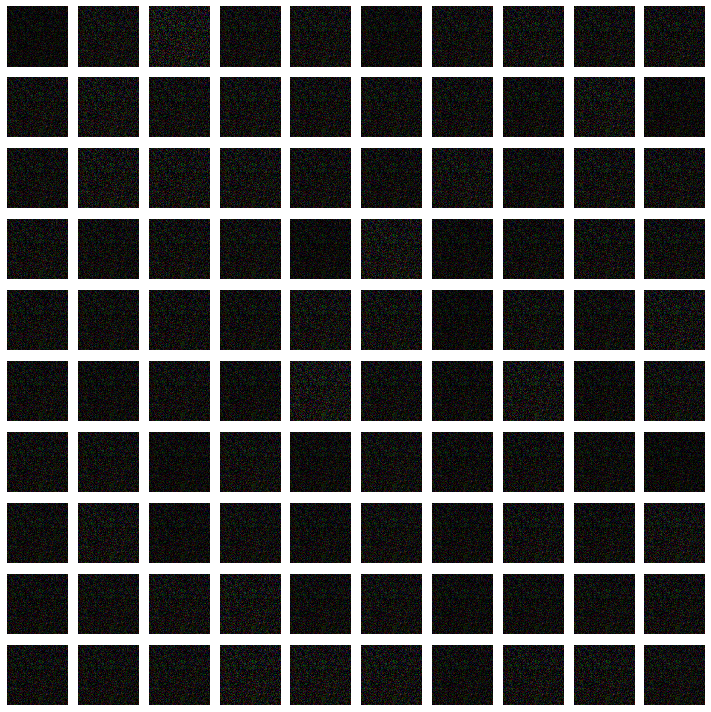

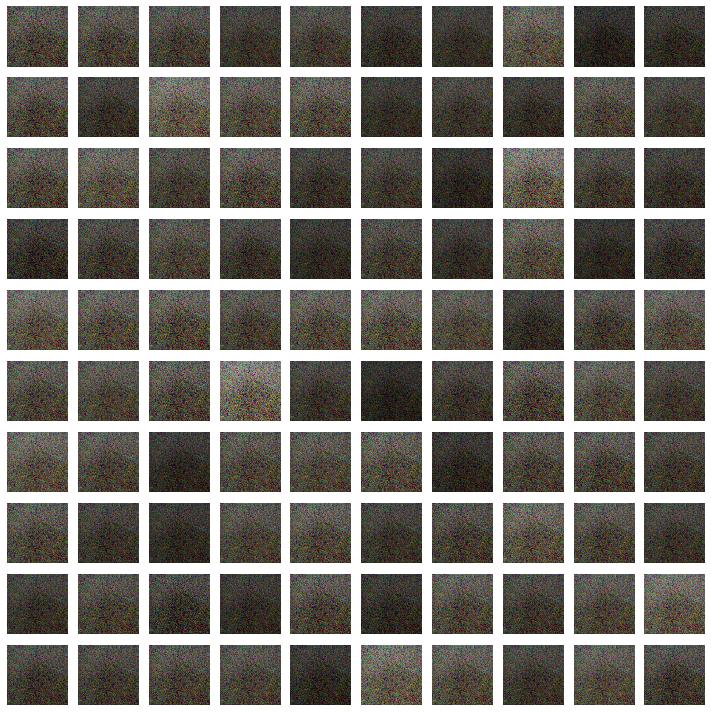

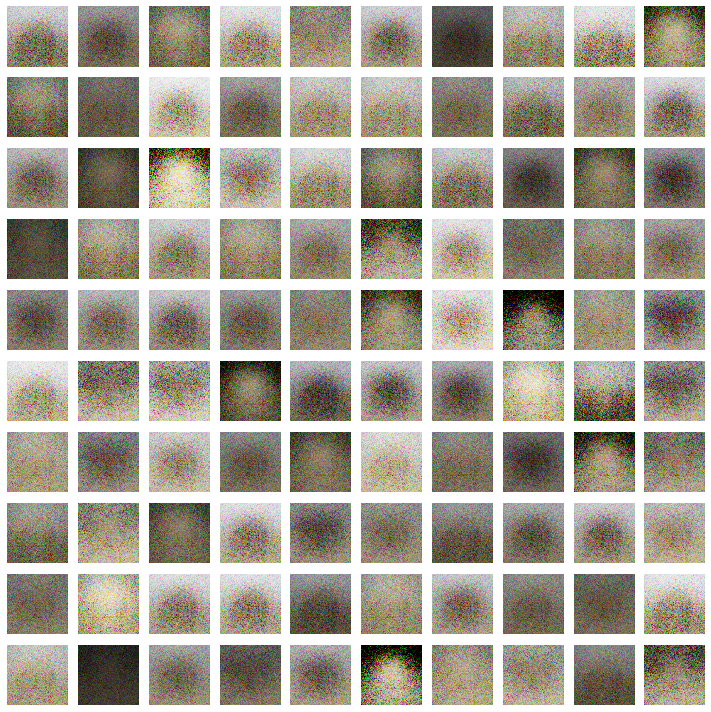

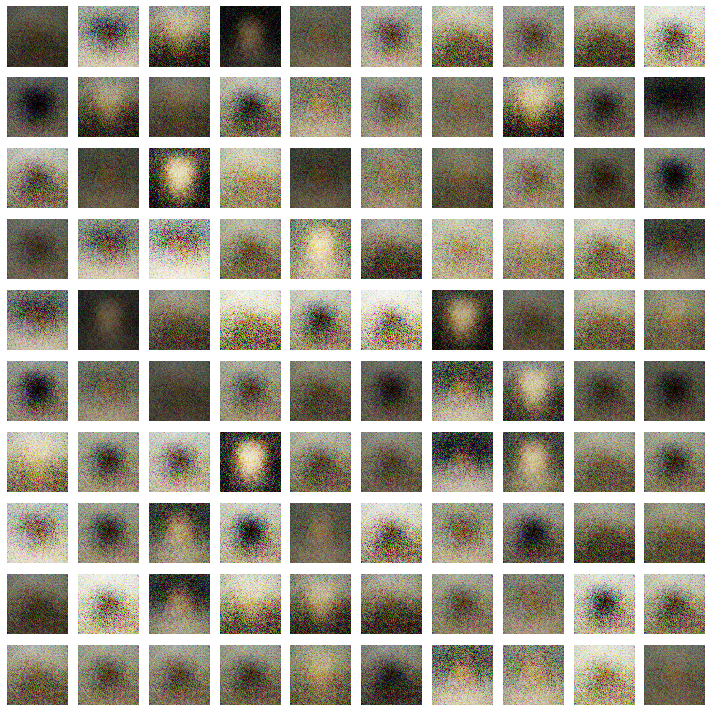

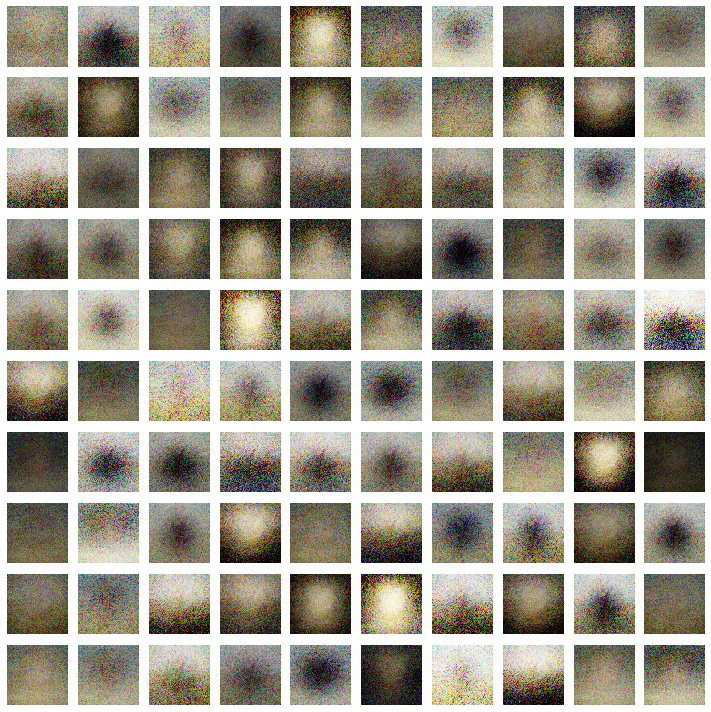

...

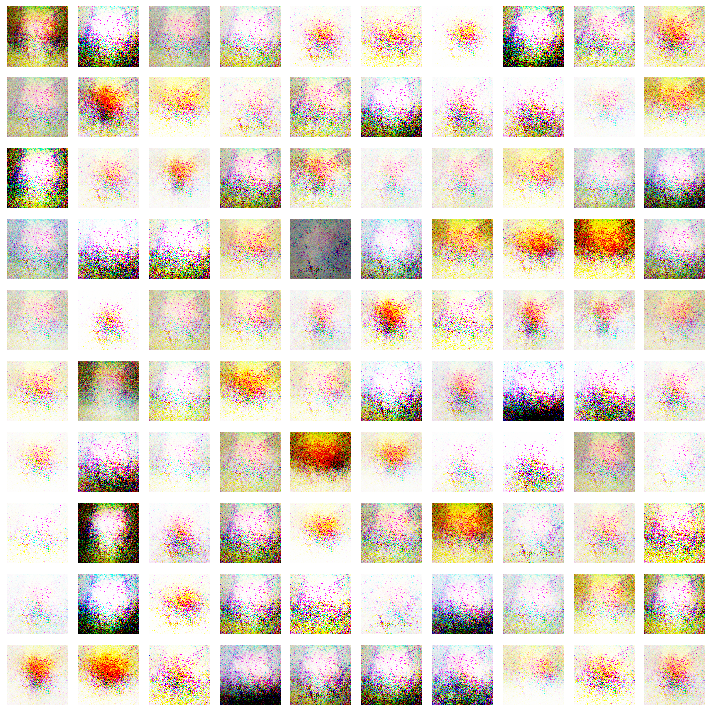

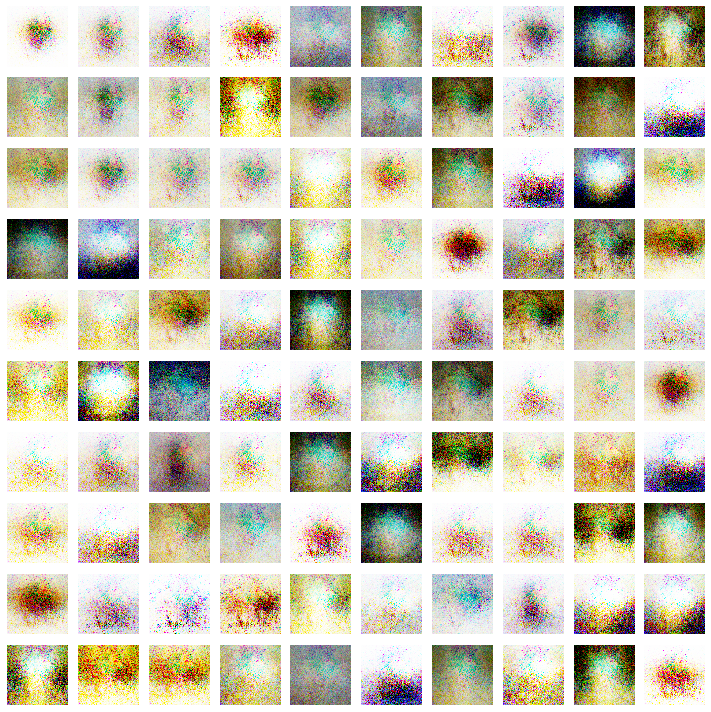

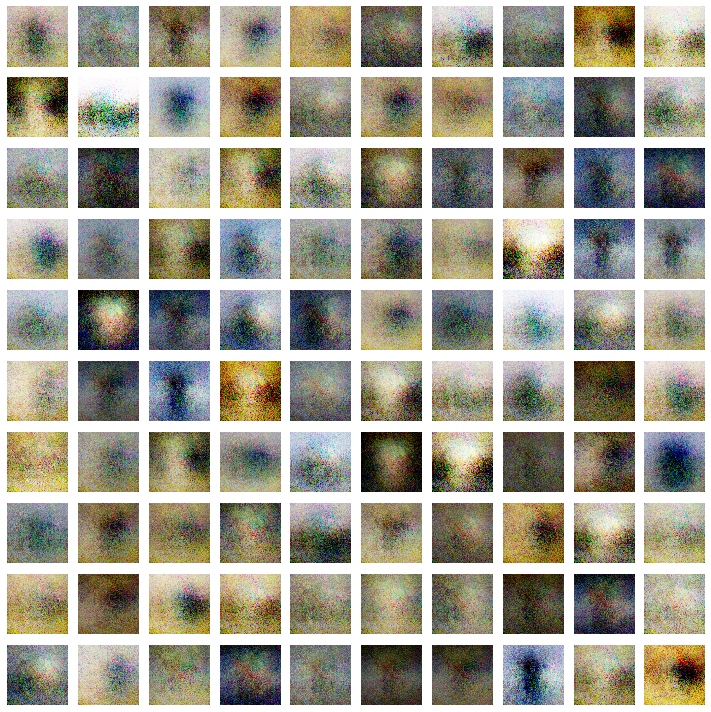

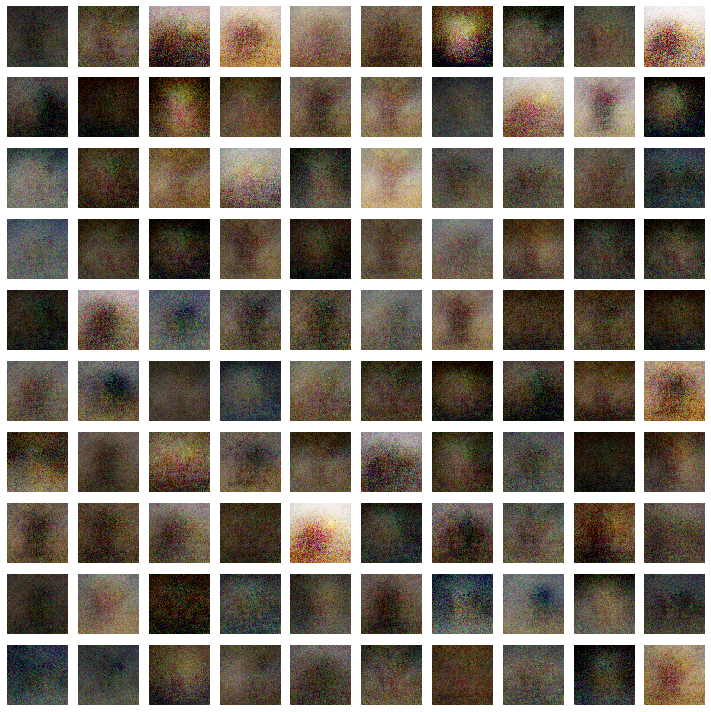

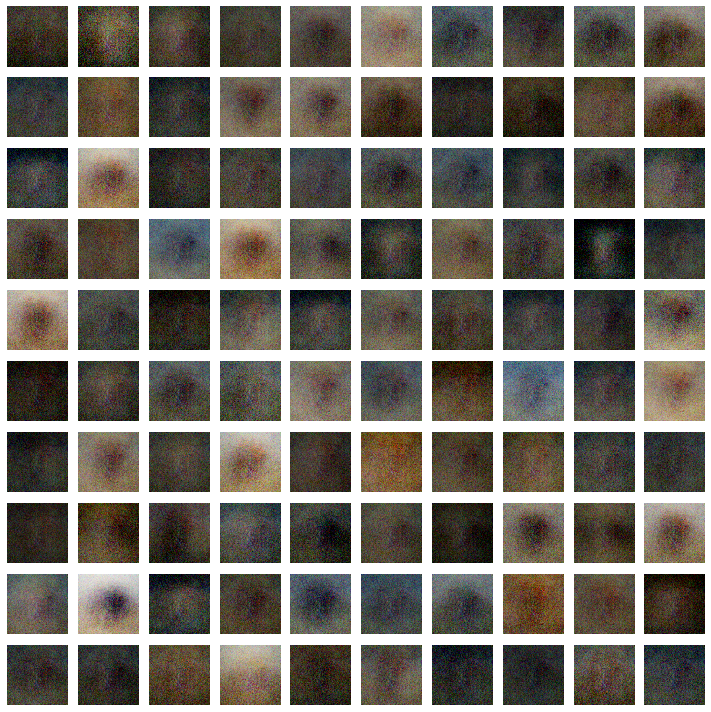

In [16]:
"""Starting the GAN training"""

def training(epochs=1, batch_size=25):
    
    #Loading the data
    #(X_train, y_train, X_test, y_test) = load_data()
    #batch_count = X_train.shape[0] / batch_size
    
    # Creating GAN
    generator= create_generator()
    discriminator= create_discriminator()
    gan = create_gan(generator,discriminator)
    
    for e in range(1,epochs+1 ):
        print("Epoch %d" %e)
        for _ in tqdm(range(batch_size)):
        #generate  random noise as an input  to  initialize the  generator
            noise= np.random.normal(0,1, [batch_size, 100])
            
            # Generate fake animal images from noised input
            generated_images = generator.predict(noise)
            
            # Get a random set of  real images
            image_batch, _ = training_data.next()
            image_batch = image_batch.reshape(-1,height*width*channels) 
            #image_batch =X_train[np.random.randint(low=0,high=X_train.shape[0],size=batch_size)]
            
            # Construct different batches of real and fake data 
            X= np.concatenate([image_batch, generated_images])
            
            # Labels for generated and real data
            y_dis=np.zeros(2*batch_size)
            y_dis[:batch_size]=0.9
            
            #Pre train discriminator on  fake and real data  before starting the gan. 
            discriminator.trainable=True
            discriminator.train_on_batch(X, y_dis)
            
            #Tricking the noised input of the Generator as real data
            #noise= np.random.normal(0,1, [batch_size, 100])
            y_gen = np.ones(batch_size)
            
            # During the training of gan, 
            # the weights of discriminator should be fixed. 
            #We can enforce that by setting the trainable flag
            discriminator.trainable=False
            
            #training  the GAN by alternating the training of the Discriminator 
            #and training the chained GAN model with Discriminator’s weights freezed.
            gan.train_on_batch(noise, y_gen)
            
        if e == 1 or e % 20 == 0:
           
            plot_generated_images(e, generator)

    return generator
genrtr = training(400,batch_size)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

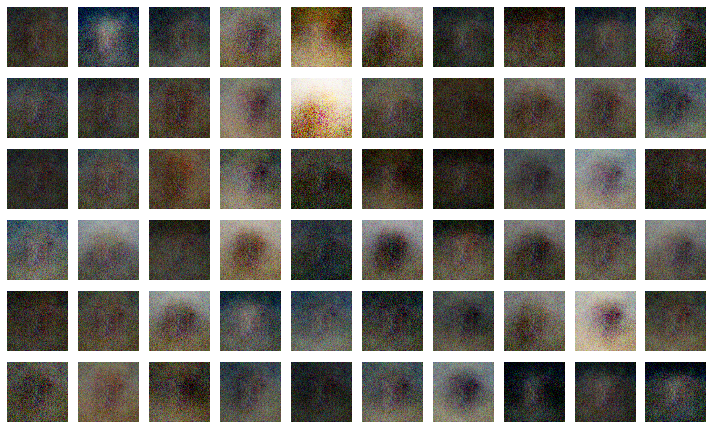

In [20]:

def generate_example(generator, examples=100, dim=(10,10), figsize=(10,10)):
    noise= np.random.normal(loc=0, scale=1, size=[examples, 100])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(examples,100,100,3)
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='none')
        plt.axis('off')
    plt.tight_layout()
    
generate_example(genrtr,60)

In [18]:
"""Creating a GIF out of the saved images"""

import imageio
import glob

anim_file = 'gan_imgs.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('gan*.png')
  filenames = sorted(filenames)
  last = -1
  for i,filename in enumerate(filenames):
    frame = 2*(i**0.5)
    if round(frame) > round(last):
      last = frame
    else:
      continue
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


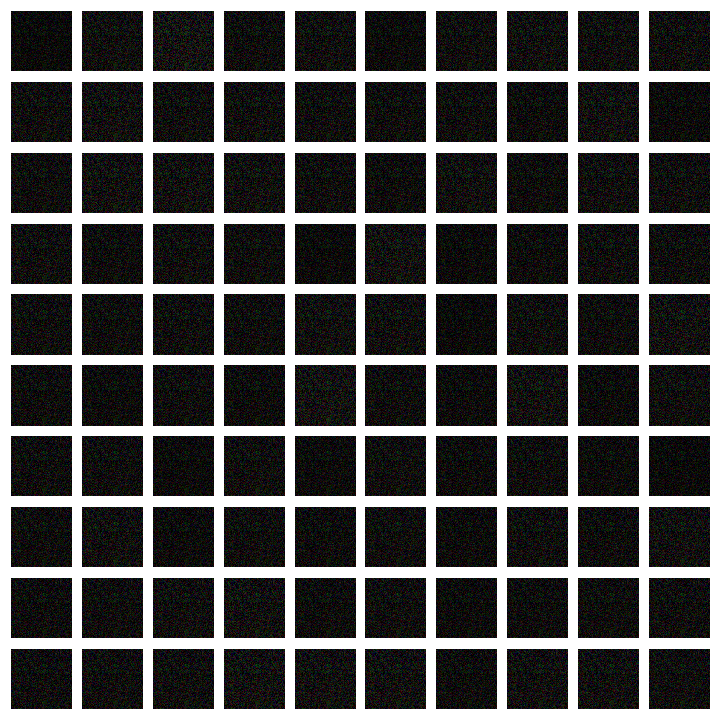

In [19]:
"""Viewing the GIF here"""

import IPython
from IPython.display import Image
Image(anim_file, format='png')